<a href="https://colab.research.google.com/github/JALVARADORUIZ/Magister_BigData_UB/blob/main/M7_AI3_AlvaradoRuizJoseArmando.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*PADAWAN*: 


##JOSE ARMANDO ALVARADO RUIZ


**Entrega: TRANSFERENCIA DE ESTILO**


# **Descripción de la tarea**

###Contexto

En 2016 se publicó el artículo Image Style Transfer Using Convolutional Neural Networks.

Este artículo describe el mecanismo de Style Transfer o “transferencia de estilo” mediante el cual se crea una nueva imagen combinando: 

Las características de alto nivel (o contenido) de una imagen, normalmente una foto. Se encuentran en las últimas capas de una Red Neuronal Convolucional o CNN. 

Las características de bajo nivel (o estilo) de otra imagen, normalmente un cuadro. Se encuentran en las primeras capas de una CNN. 

En esta práctica vamos a aplicar este modelo a pares de imágenes, y modificaremos distintos parámetros para ver el efecto sobre la imagen final.

Te pedimos que realices las siguientes tareas en el Colab proporcionado: 
1. Carga de las imágenes: mantén las imágenes seleccionadas por defecto o elige una imagen de contenido y otra de estilo.
2. Transfer learning: 
    - Carga en pytorch el modelo VGG19 pre-entrenado y asígnale a la variable vgg_all.
    - Carga en vgg_classifier el bloque de clasificación de vgg_all y muestra su arquitectura.
      - **Pregunta 1:** ¿cuántas capas lineales contiene?
      - **Pregunta 2:** ¿Cuántas clases distintas puede reconocer VGG19 por defecto? 

  - Carga en vgg_features el bloque de características de vgg_all. Es el que utilizaremos en el resto de la actividad.
    - **Pregunta 3:** Indica los identificadores de capas convolucionales a continuación de capas de max pooling.
3. Inicializar y ejecutar la Red Neuronal con los parámetros iniciales.
4. Modificar parámetros y volver a ejecutar la Red Neuronal: 
  - Content_weight (peso del error en la capa de contenido) y style_weight (peso del error en las capas de estilo): probar con [1 y 1e6], [1e2 y 1e2], [1e2 y 1e-2]. 
  - Learning rate (tasa de aprendizaje del optimizador): probar con 0.003, 0.01, 0.1. 
  - Steps (etapas de entrenamiento): probar con 500, 1000, 2000.
    - **Pregunta 4:** ¿qué influencia tienen los cambios anteriores en las imágenes intermedias y en la imagen resultante? 

Consideraciones: 
Framework a utilizar: Pytorch. 

Recuerda activar la GPU en el menú “Entorno de ejecución” => “Cambiar tipo de entorno de ejecución”.

# Neural Style Transfer
En el pdf de la actividad se describe brevemente el método de generación de imágenes **Neural Style Transfer**. No se pretende adquirir un conocimiento profundo de este método sino utilizar la práctica para adquirir un **conocimiento intuitivo de las Redes Neuronales Convolucionales como extractores de características**.

En primer lugar, importamos PyTorch junto con otros paquetes.

In [69]:
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import matplotlib.image as img
import numpy as np

import torch
import torch.optim as optim
import requests
from torchvision import transforms, models
from google.colab import files

## Transfer Learning: descargamos VGG19 
En esta actividad vamos a utilizar el primer bloque de VGG19, que sirve para **extraer las características** de la imagen de entrada

In [70]:
# reutilizamos el modelo pre-entrenado VGG19
vgg_all = models.vgg19(pretrained=True)

# pero seleccionamos solo el primer bloque de la red que extrae features
vgg_features = vgg_all.features

# congelamos porque solo queremos optimizar la imagen target
for param in vgg_features.parameters():
    param.requires_grad_(False)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


## VGG19 - Clasificador
Aunque en esta práctica solo vamos a utilizar el bloque extractor de características, podemos aprovechar para echarle un vistazo al bloque de **clasificación**.

Comprobamos que el segundo bloque, el clasificador, está compuesto por:
* capas lineales (Linear)
* funciones de activación ReLU
* capas de dropout para evitar overfitting

Si quisiéramos utilizar VGG19 como clasificador de un dataset de imágenes, deberíamos sustituir este bloque por otro similar con tantas salidas como clases haya en el dataset. 

In [71]:
vgg_classifier = vgg_all.classifier
print(vgg_classifier)

Sequential(
  (0): Linear(in_features=25088, out_features=4096, bias=True)
  (1): ReLU(inplace=True)
  (2): Dropout(p=0.5, inplace=False)
  (3): Linear(in_features=4096, out_features=4096, bias=True)
  (4): ReLU(inplace=True)
  (5): Dropout(p=0.5, inplace=False)
  (6): Linear(in_features=4096, out_features=1000, bias=True)
)


## Pasamos modelo a GPU si está disponible

In [72]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg_features.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

## load_image
Función para cargar una imagen

In [73]:
def load_image(img_path, max_size=300, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= max_size pixels in the x-y dims.'''
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape

    # VGG está normalizada con los valores de Imagenet: 0.406, 0.456, 0.485 en BGR, que invertimos en RGB.
    # En rango 0-255 seria 103.94, 116.78, 123.68 en BGR
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # con :3 eliminamos el último canal de la primera dimensión, que es el alfa e indica la transparencia
    # con unsqueeze(0) añadimos como primera dimensión el batch
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

## Carga de las imágenes de contenido y estilo
Además, cambiamos tamaño de la imagen de estilo a la de contenido.

In [74]:
# cargamos las imágenes de contenido y estilo
img_quinta = "https://github.com/albertojulian/master-ub/raw/main/quinta.jpeg"
img_palamos = "https://github.com/albertojulian/master-ub/raw/main/playa_palamos.jpg"
img_soto = "https://github.com/albertojulian/master-ub/raw/main/soto_cruz_mazo.jpg"

content = load_image(img_soto).to(device)

img_van_gogh = "https://upload.wikimedia.org/wikipedia/commons/thumb/e/ea/Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg"
img_kandinsky = "https://upload.wikimedia.org/wikipedia/commons/b/b4/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg"

# cambia tamaño de la imagen de estilo: coge los dos últimos valores de shape de la imagen de contenido
style = load_image(img_kandinsky, shape=content.shape[-2:]).to(device)

## im_convert 
Es una función de ayuda para pasar una imagen de Tensor a numpy y poderla visualizar

In [75]:
def im_convert(tensor):
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0) # cambia ancho por alto
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

## Veamos las imágenes de contenido y estilo

Text(0.5, 1.0, 'Style Image')

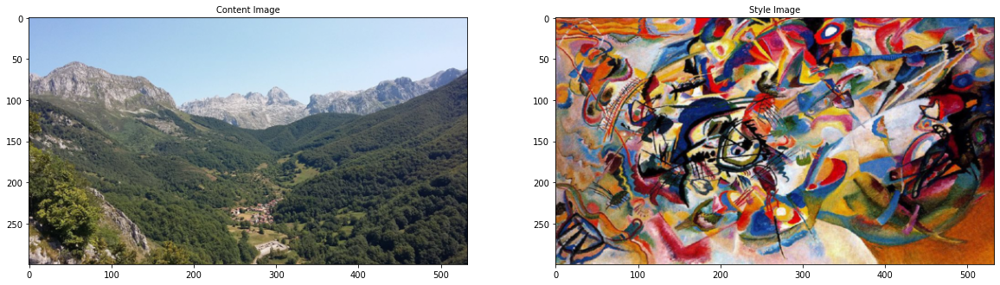

In [76]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax1.set_title("Content Image",fontsize = 10)
ax2.imshow(im_convert(style))
ax2.set_title("Style Image",fontsize = 10)

## Capas de vgg_features
Veamos los identificadores de capas del extractor de características, vgg_features

In [77]:
print(vgg_features)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

## Extracción de características
La función get_features se utiliza para extraer las características de las imágenes de contenido y estilo.

En primer lugar, filtramos las capas que vamos a tener en cuenta para la extracción de características según se indica en el artículo de referencia. Utilizaremos varias capas para el estilo pero solo una (conv4_2) para el contenido.

A continuación, extraemos las características de la imagen para las capas seleccionadas.

In [78]:
def get_features(image, model, layers=None):
    
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1', 
                  '10': 'conv3_1', 
                  '19': 'conv4_1',
                  '21': 'conv4_2',  ## contenido
                  '28': 'conv5_1'}

    features = {}
    x = image
    # model._modules es un diccionario con todas las capas
    for name, layer in model._modules.items():
        x = layer(x) # la imagen se va transformando en cada capa...
        if name in layers: # ...pero solo extraemos las características de las capas seleccionadas
            features[layers[name]] = x
            
    return features


## Matriz Gram
El método Style Transfer utiliza la matriz Gram o Gramian para procesar las características.

Ver https://en.wikipedia.org/wiki/Gramian_matrix 

In [79]:
def gram_matrix(tensor):

    # obtenemos batch_size, depth, height y width del Tensor
    b, d, h, w = tensor.size()

    # convertimos el tensor a 2D multiplicando dimensiones entre sí 
    tensor = tensor.view(b * d, h * w)
    
    # calculamos la matriz gram multiplicando el tensor por su transpuesto
    gram = torch.mm(tensor, tensor.t())
    
    return gram

## Definimos los parámetros a probar
* Definimos los pesos de las capas de estilo. Excluimos conv4_2 porque es la capa de la que extraemos el contenido.
* Definimos valores de los pesos de contenido y estilo para la función de pérdida (content_weight, style_weight).
* Definimos la tasa de aprendizaje.
* Definimos el número de iteraciones (steps)


In [80]:
style_weights = {'conv1_1': 1.,
                 'conv2_1': 0.75,
                 'conv3_1': 0.2,
                 'conv4_1': 0.2,
                 'conv5_1': 0.2}

## Inicialización y entrenamiento del modelo
Tareas:
* definimos las capas del nuevo modelo
* inicializamos la imagen generada con la imagen de contenido
* definimos el optimizador
* modificamos la imagen generada mediante la función de pérdida, compuesta por la suma de la pérdida de estilo y la de contenido ponderadas

In [81]:
def train_model(content, style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every):
  # extraemos características de contenido y estilo de las imágenes originales
  content_features = get_features(content, vgg_features)
  style_features = get_features(style, vgg_features)

  # calculamos la matriz gram de cada capa de estilo
  style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

  # creamos una tercera imagen "target" que se va a ir modificando
  # La inicializamos con la imagen de contenido...
  # ...y le vamos cambiando el estilo
  target = content.clone().requires_grad_(True).to(device)

  # definimos el optimizador sobre los parámetros de la imagen target
  optimizer = optim.Adam([target], lr=learning_rate)

  # Variables acumulativas para gráficar
  total_loss_array = []
  content_loss_array = []
  style_loss_array = []

  print(f"Optimizando con content_weight: {content_weight} - style_weight: {style_weight} - learning_rate: {learning_rate} - Epoch: {steps}")
  for ii in range(1, steps+1):
    
    # extraemos las características de la imagen generada
    target_features = get_features(target, vgg_features)
    
    # definimos la función de pérdida de contenido
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    # definimos la función de pérdida de estilo como suma de la pérdida de cada capa
    style_loss = 0
    for layer in style_weights:
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        _, d, h, w = target_feature.shape
        style_gram = style_grams[layer]
        # calculamos la "pérdida de estilo" de la capa actual y la ponderamos 
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        # la añadimos a la pérdida de estilo
        style_loss += layer_style_loss / (d * h * w)
        
    # calculamos la pérdida total
    total_loss = content_weight * content_loss + style_weight * style_loss
    
    content_loss_array.append(round(content_loss.item(),4))
    style_loss_array.append(round(style_loss.item(),4))

    # actualizamos la imagen generada mediante el optimizador
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # mostramos las imágenes intermedias y su pérdida
    if  ii % show_every == 0:
        print(f"Iteracion {ii} \nTotal Loss: {total_loss.item()} - Content Loss: {content_loss.item()} - Style Loss: {style_loss.item()}")
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 12))
        ax1.imshow(im_convert(content))
        ax1.set_title("Original Image",fontsize = 12)
        ax2.imshow(im_convert(target))
        ax2.set_title("Generated Image", fontsize = 12)
        plt.show()
  
  return content_loss_array, style_loss_array, target


def grafica_loss(content_loss_array, style_loss_array,filename):
  # Gráficamos las perdidas de Content y Style
  plt.figure(figsize=(16,12))
  plt.plot(content_loss_array, label='Content loss')
  plt.plot(style_loss_array, label='Style loss')
  plt.legend()
  plt.savefig(filename)
  plt.show()
  plt.close()

def save_target(target, filename):
  target_path = filename

  target_im = im_convert(target)
  target_im = target_im * 255
  target_im = target_im.astype('uint8')
  Image.fromarray(target_im).save(target_path) 

  files.download(target_path)

**Parámetros iniciales**

In [82]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.1

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.1 - Epoch: 500
Iteracion 100 
Total Loss: 3649694.5 - Content Loss: 13.66267204284668 - Style Loss: 3.6496808528900146


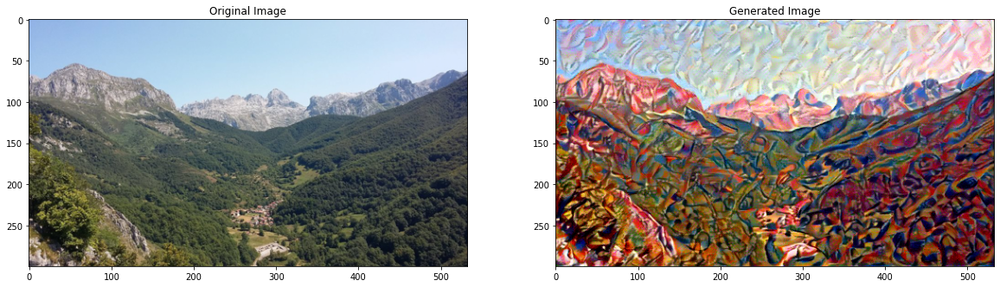

Iteracion 200 
Total Loss: 1509155.375 - Content Loss: 14.12756061553955 - Style Loss: 1.509141206741333


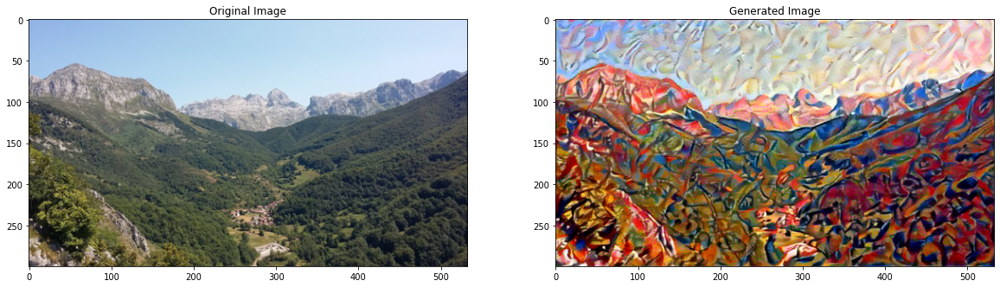

Iteracion 300 
Total Loss: 893384.125 - Content Loss: 14.357407569885254 - Style Loss: 0.893369734287262


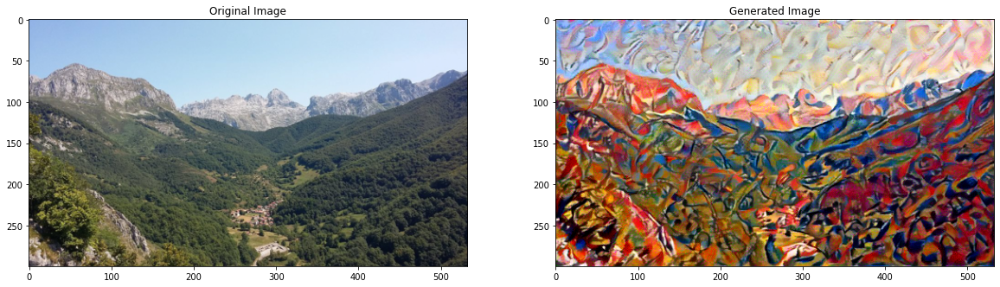

Iteracion 400 
Total Loss: 647236.0 - Content Loss: 14.448238372802734 - Style Loss: 0.647221565246582


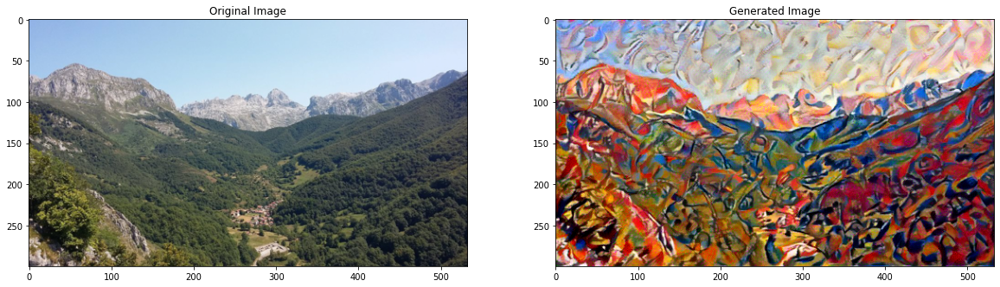

Iteracion 500 
Total Loss: 585525.875 - Content Loss: 14.606401443481445 - Style Loss: 0.5855112671852112


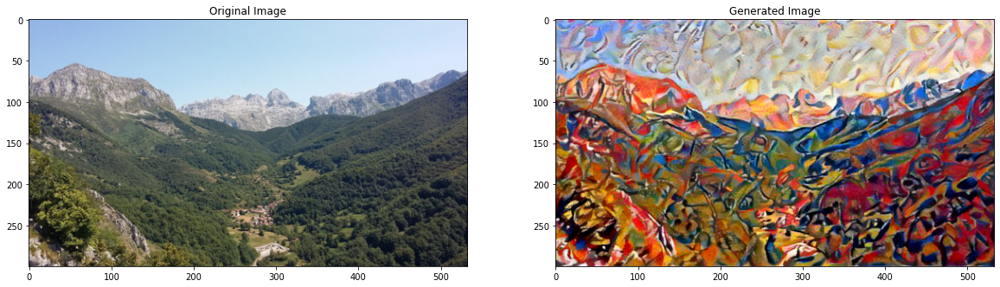

In [83]:
## Llamamos a entrenar a nuestro modelo:

content_loss_array, style_loss_array, target1 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

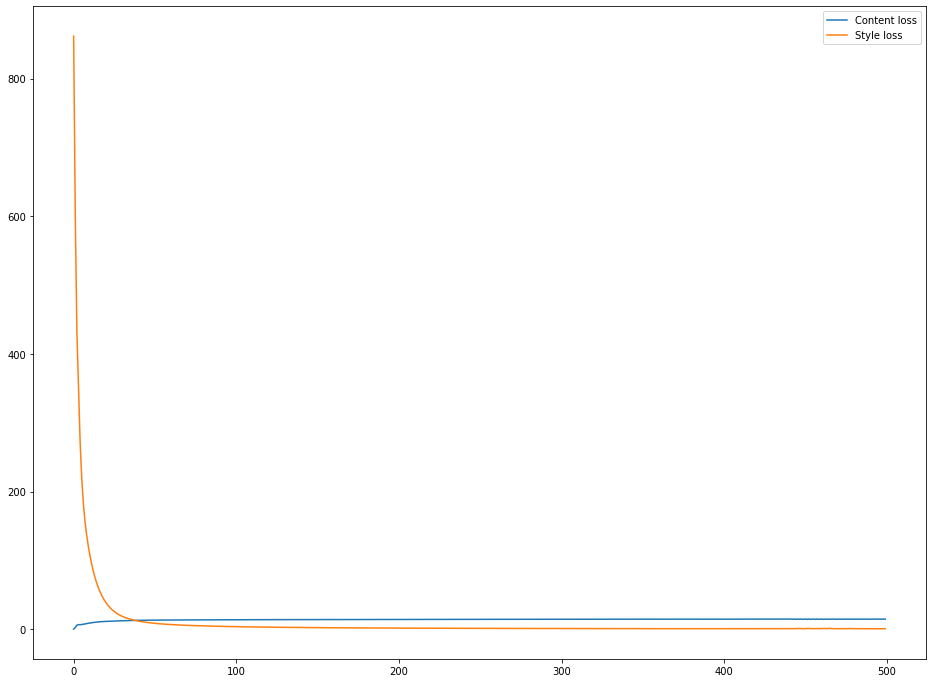

In [84]:
grafica_loss(content_loss_array, style_loss_array,"graf_1.png")


## Almacenamiento en local
Por último, si queremos conservar la imagen resultante, podemos bajarla imagen a nuestro ordenador.

In [85]:
save_target(target1, "01_contenweight_1_styleweight_1e6.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Content_weight (peso del error en la capa de contenido) y style_weight (peso del error en las capas de estilo): [1e2 y 1e2]**

In [86]:
content_weight = 1e2  # alpha
style_weight = 1e2  # beta

learning_rate = 0.1

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 100.0 - style_weight: 100.0 - learning_rate: 0.1 - Epoch: 500
Iteracion 100 
Total Loss: 1036.8394775390625 - Content Loss: 5.266397476196289 - Style Loss: 5.101997375488281


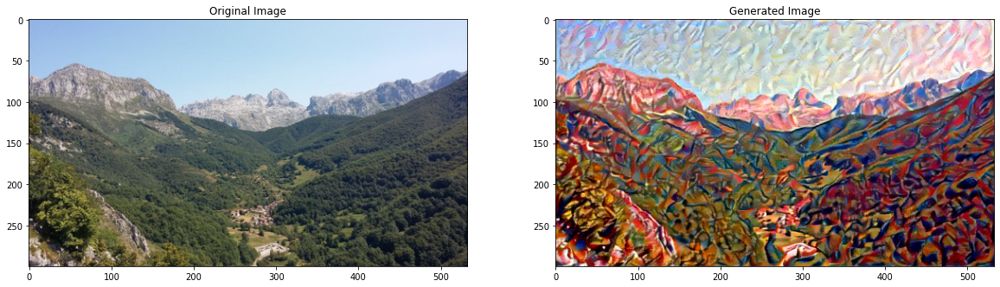

Iteracion 200 
Total Loss: 742.705810546875 - Content Loss: 4.489397048950195 - Style Loss: 2.9376606941223145


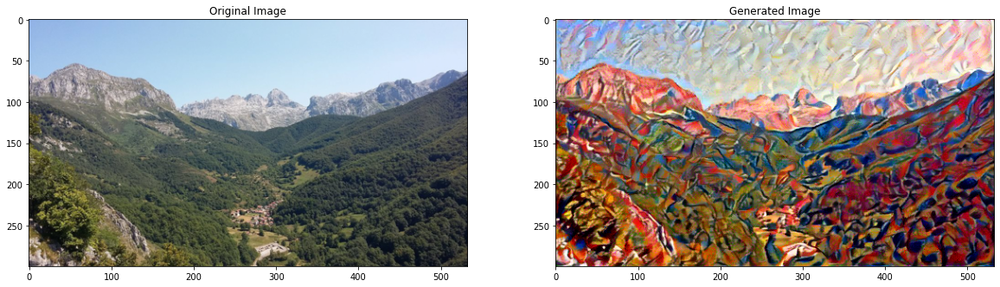

Iteracion 300 
Total Loss: 641.8834228515625 - Content Loss: 4.143276214599609 - Style Loss: 2.275557518005371


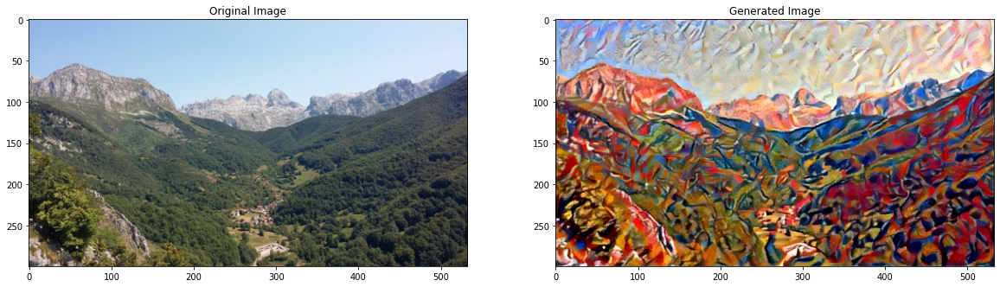

Iteracion 400 
Total Loss: 601.205322265625 - Content Loss: 3.904782772064209 - Style Loss: 2.1072704792022705


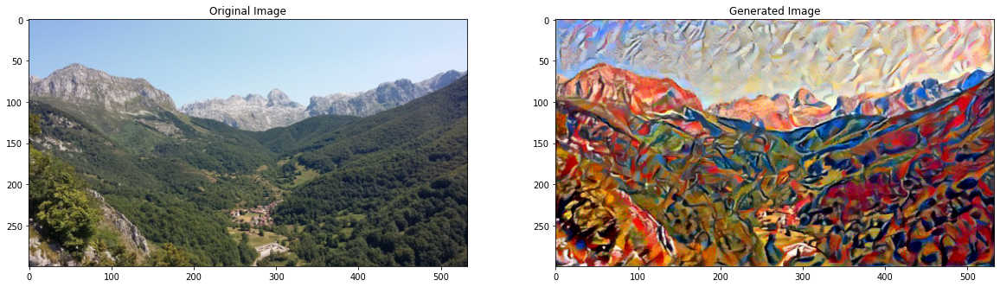

Iteracion 500 
Total Loss: 594.4632568359375 - Content Loss: 3.789165735244751 - Style Loss: 2.1554665565490723


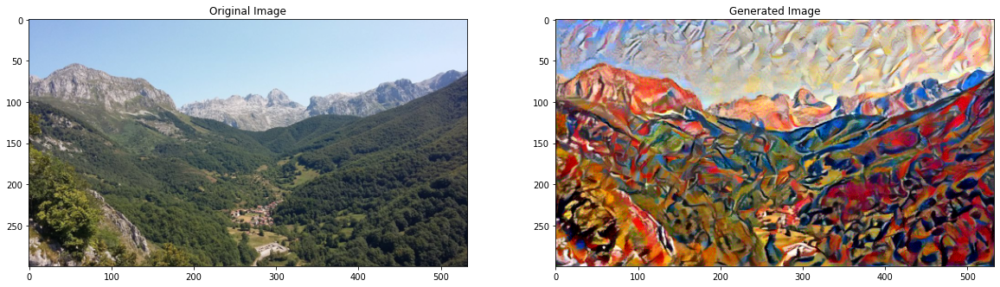

In [87]:
content_loss_array, style_loss_array, target2 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

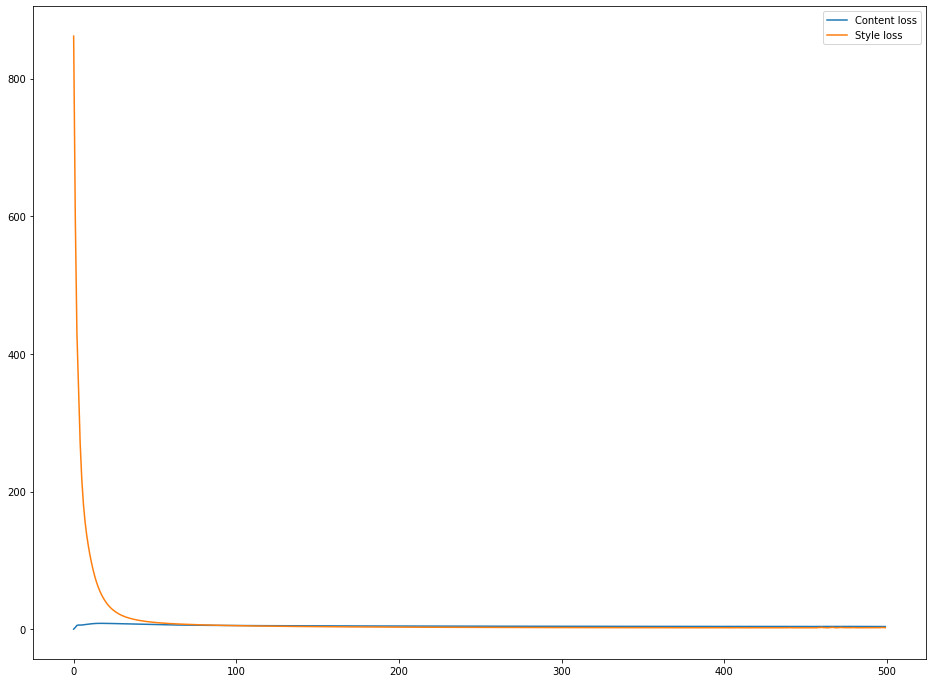

In [88]:
grafica_loss(content_loss_array, style_loss_array,"graf_2.png")

In [89]:
# Almacenamos imagen
save_target(target2, "02_contenweight_1e2_styleweight_1e2.jpg.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Content_weight (peso del error en la capa de contenido) y style_weight (peso del error en las capas de estilo): [1e2 y 1e-2]**

In [90]:
content_weight = 1e2  # alpha
style_weight = 1e-2  # beta

learning_rate = 0.1

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 100.0 - style_weight: 0.01 - learning_rate: 0.1 - Epoch: 500
Iteracion 100 
Total Loss: 9.25999641418457 - Content Loss: 0.042575471103191376 - Style Loss: 500.24493408203125


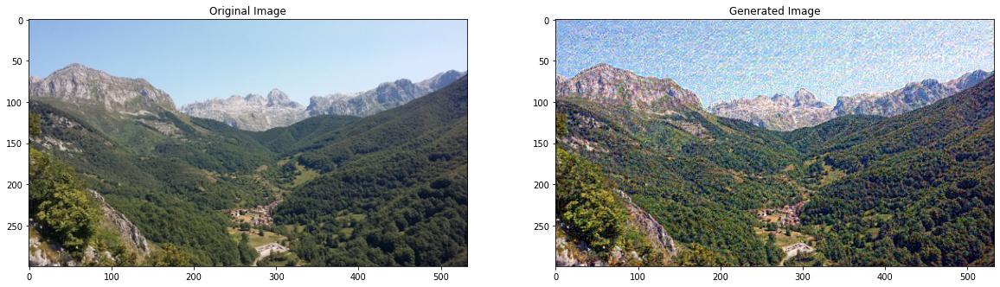

Iteracion 200 
Total Loss: 6.883247375488281 - Content Loss: 0.030296823009848595 - Style Loss: 385.35650634765625


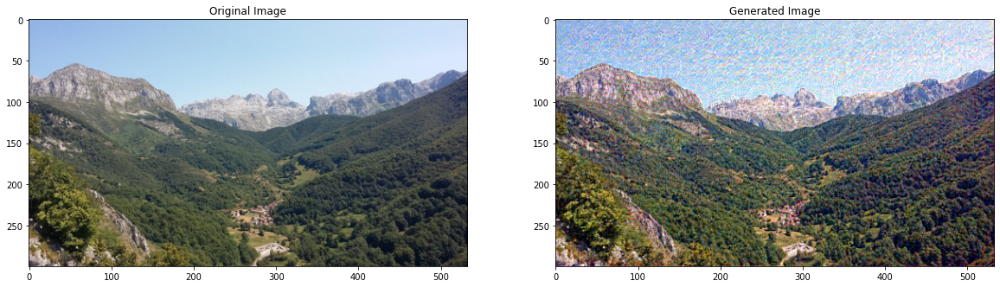

Iteracion 300 
Total Loss: 5.956141471862793 - Content Loss: 0.026330580934882164 - Style Loss: 332.3083190917969


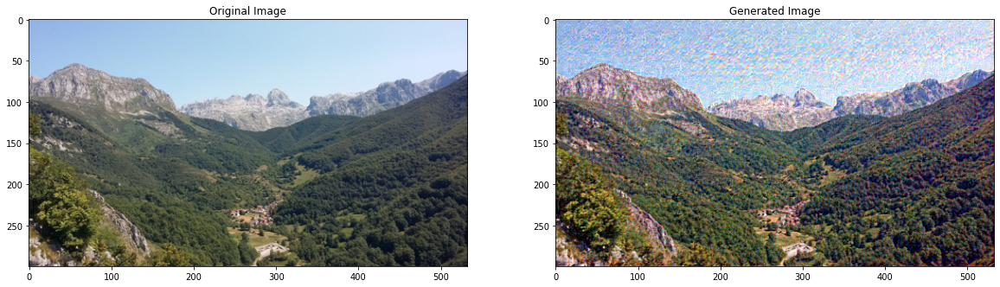

Iteracion 400 
Total Loss: 5.430839538574219 - Content Loss: 0.024023374542593956 - Style Loss: 302.8501892089844


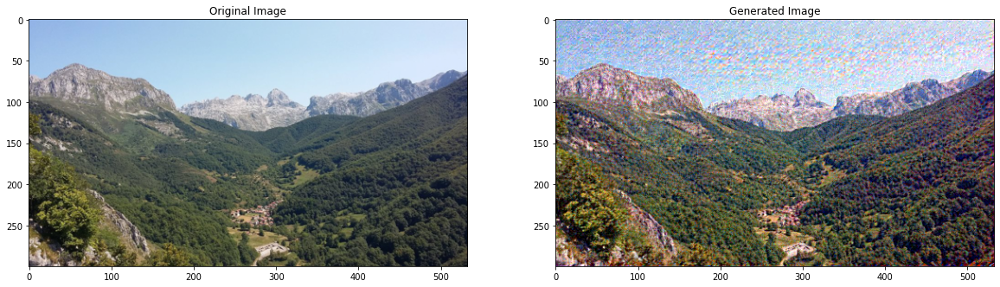

Iteracion 500 
Total Loss: 4.915423393249512 - Content Loss: 0.021087244153022766 - Style Loss: 280.6698913574219


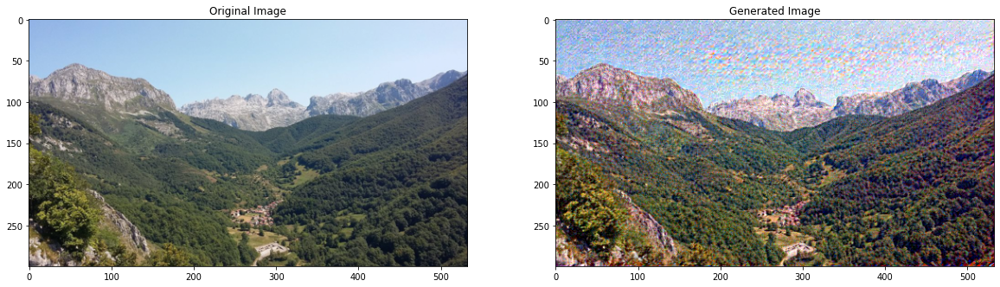

In [91]:
content_loss_array, style_loss_array, target3 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

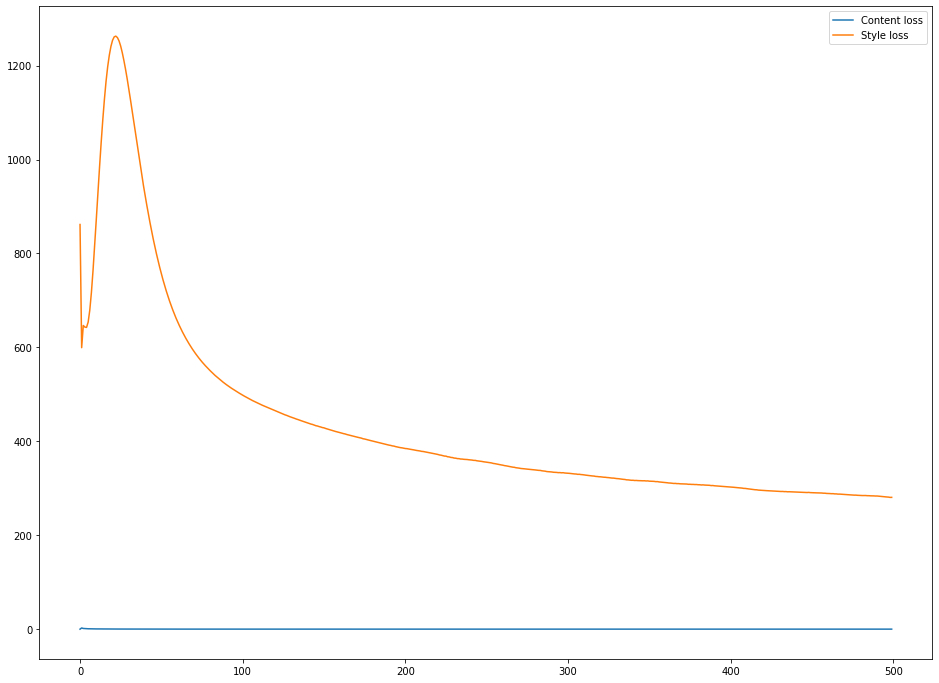

In [92]:
grafica_loss(content_loss_array, style_loss_array,"graf_3.png")

In [93]:
# Almacenamos imagen
save_target(target3, "03_contenweight_1e2_styleweight_1e-2.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Learning rate (tasa de aprendizaje del optimizador): probar con 0.003**

In [94]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.003

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.003 - Epoch: 500
Iteracion 100 
Total Loss: 212082064.0 - Content Loss: 7.421397686004639 - Style Loss: 212.08206176757812


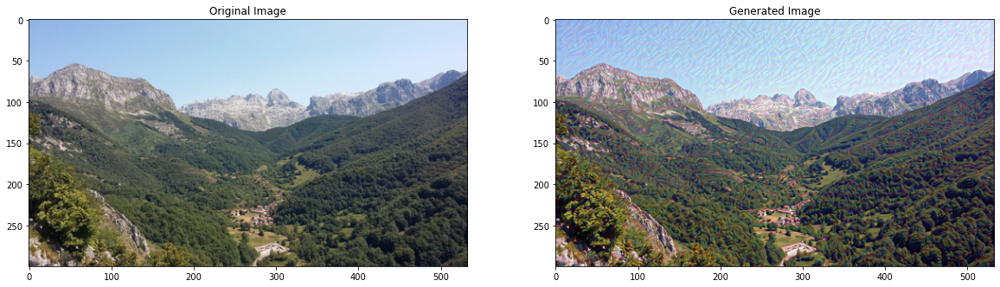

Iteracion 200 
Total Loss: 94373472.0 - Content Loss: 9.587760925292969 - Style Loss: 94.37346649169922


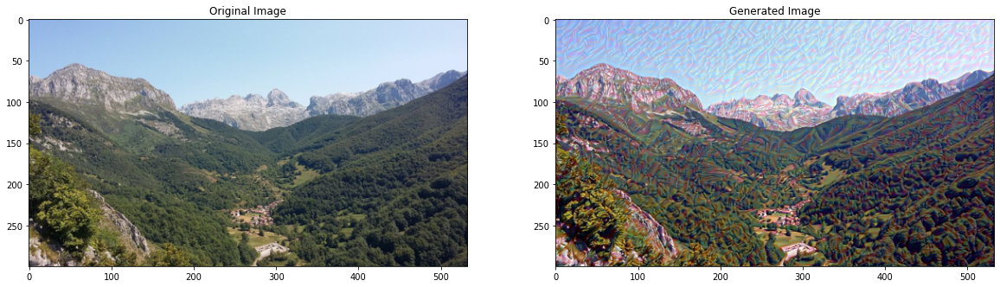

Iteracion 300 
Total Loss: 57480828.0 - Content Loss: 10.705204963684082 - Style Loss: 57.48081588745117


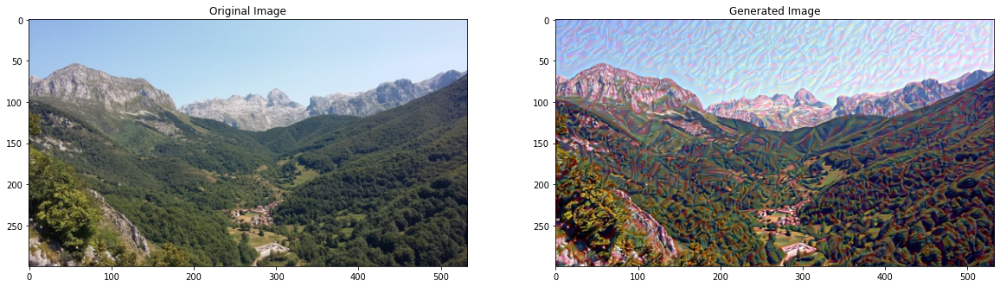

Iteracion 400 
Total Loss: 39730500.0 - Content Loss: 11.344681739807129 - Style Loss: 39.73048782348633


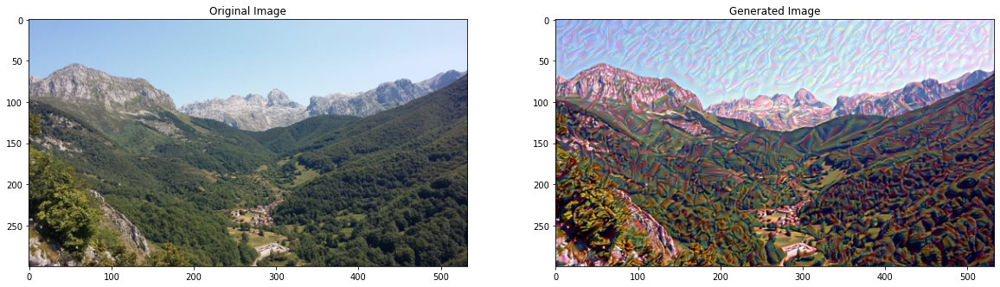

Iteracion 500 
Total Loss: 29465120.0 - Content Loss: 11.76619815826416 - Style Loss: 29.46510887145996


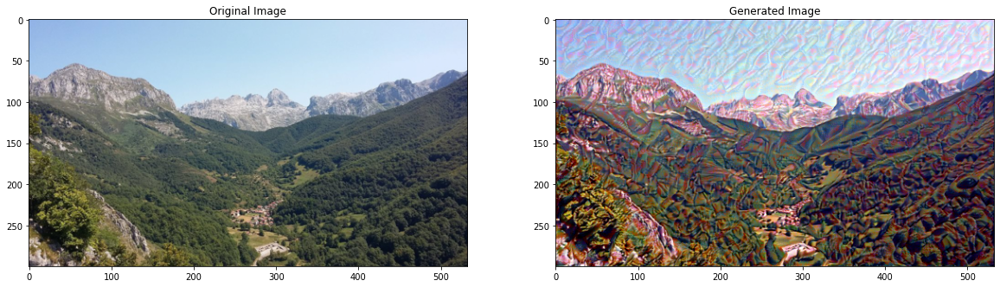

In [95]:
content_loss_array, style_loss_array, target4 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

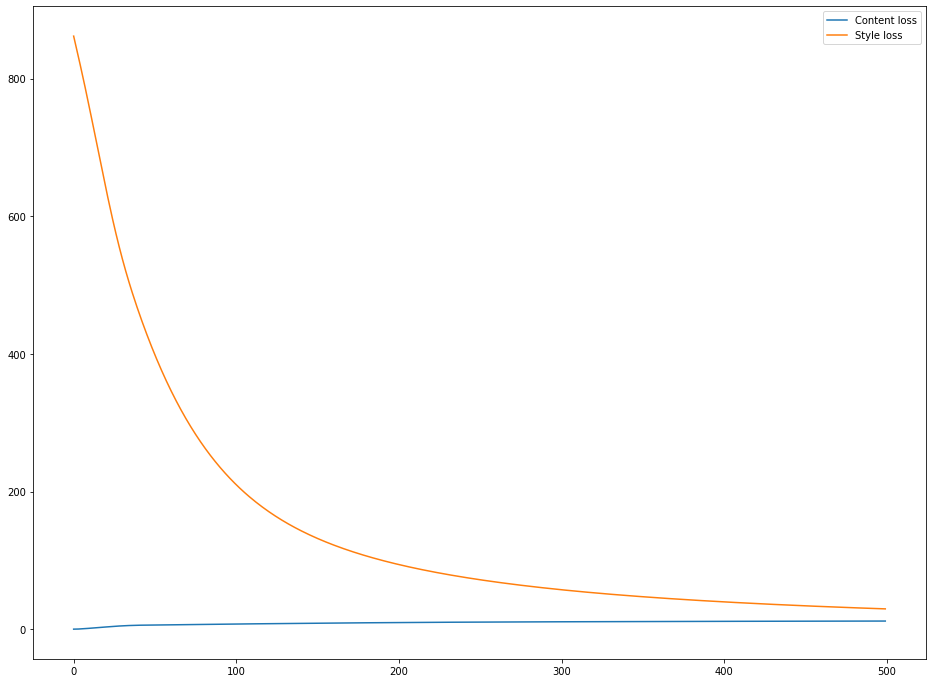

In [96]:
grafica_loss(content_loss_array, style_loss_array,"graf_4.png")

In [97]:
# Almacenamos imagen
save_target(target4, "04_learningrate_0.003.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Learning rate (tasa de aprendizaje del optimizador): 0.01**

In [98]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.01

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.01 - Epoch: 500
Iteracion 100 
Total Loss: 54072980.0 - Content Loss: 10.726360321044922 - Style Loss: 54.072967529296875


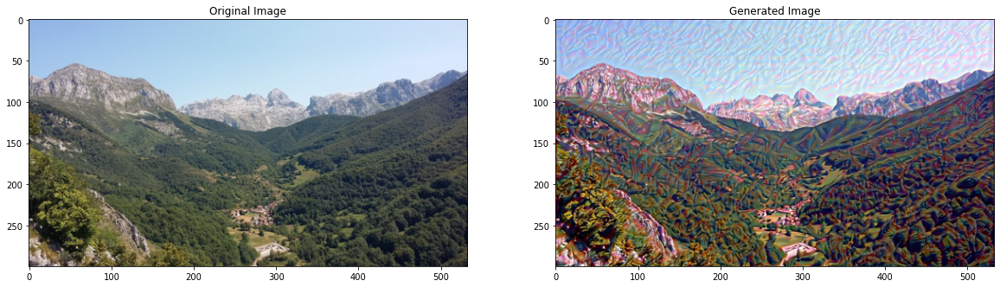

Iteracion 200 
Total Loss: 21974244.0 - Content Loss: 12.136131286621094 - Style Loss: 21.974231719970703


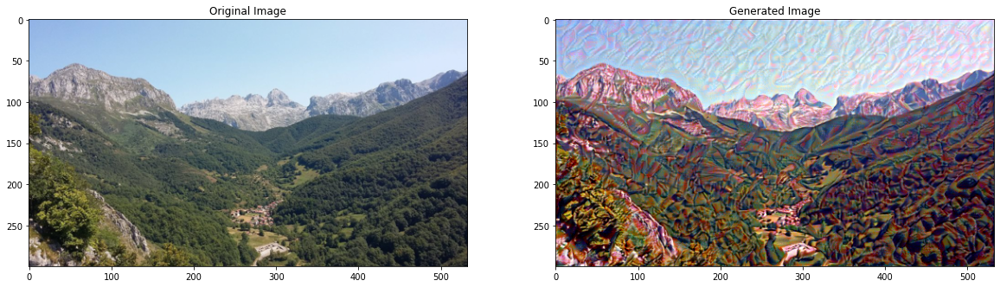

Iteracion 300 
Total Loss: 12952050.0 - Content Loss: 12.757160186767578 - Style Loss: 12.95203685760498


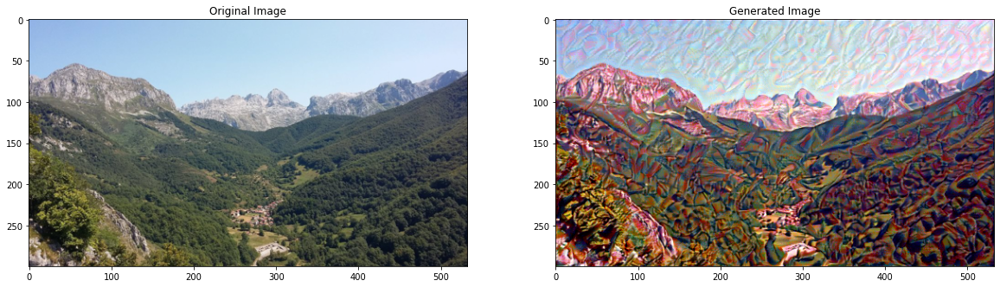

Iteracion 400 
Total Loss: 9010127.0 - Content Loss: 13.103780746459961 - Style Loss: 9.010113716125488


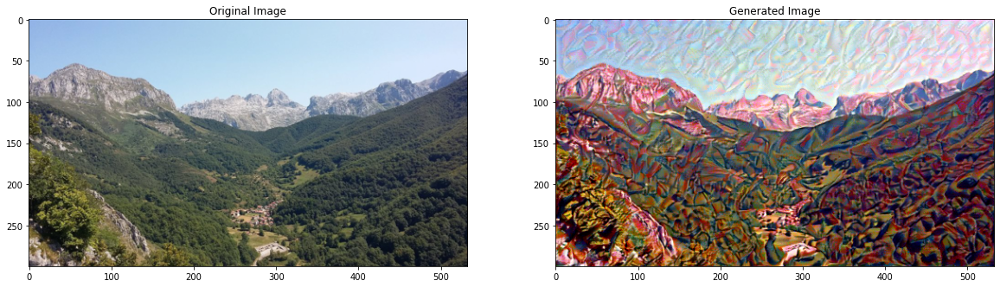

Iteracion 500 
Total Loss: 6808798.5 - Content Loss: 13.31634521484375 - Style Loss: 6.8087849617004395


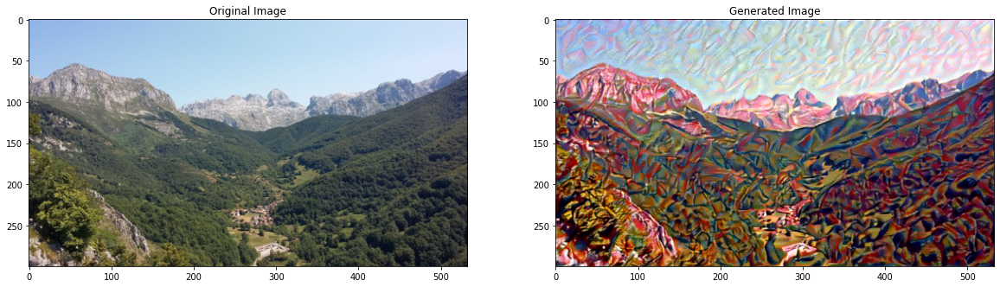

In [99]:
content_loss_array, style_loss_array, target5 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

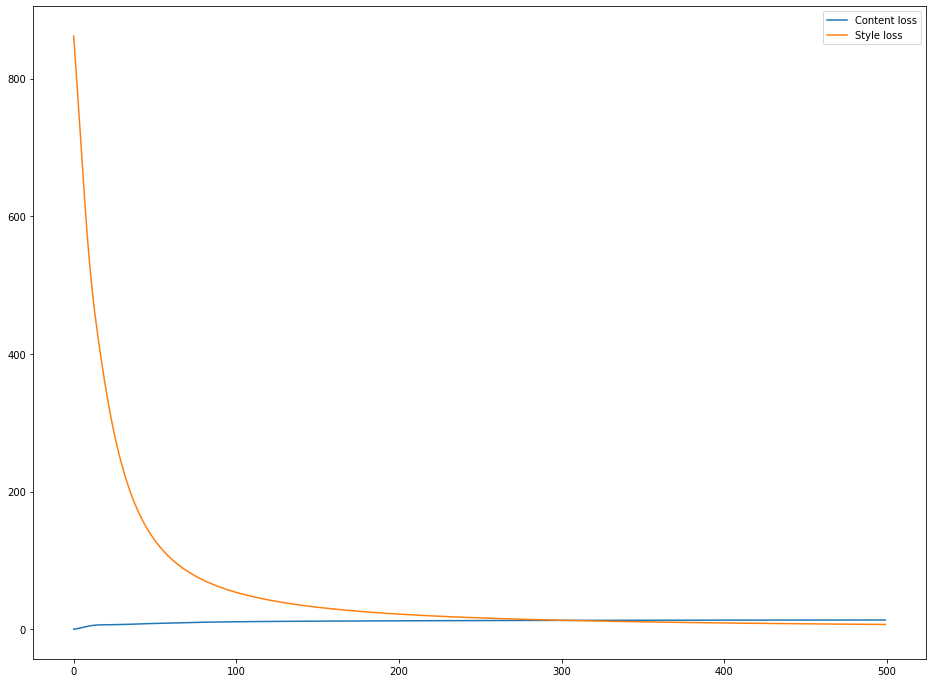

In [100]:
grafica_loss(content_loss_array, style_loss_array,"graf_5.png")

In [101]:
# Almacenamos imagen
save_target(target5, "05_learningrate_0.01.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Learning rate (tasa de aprendizaje del optimizador): 0.001**

In [102]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.001

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.001 - Epoch: 500
Iteracion 100 
Total Loss: 495268736.0 - Content Loss: 5.31519079208374 - Style Loss: 495.26873779296875


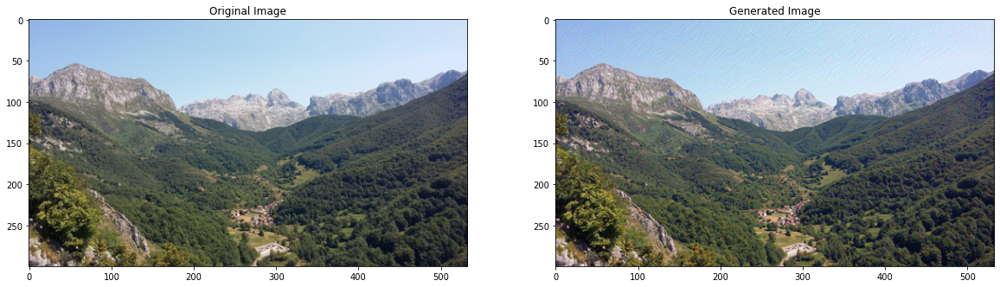

Iteracion 200 
Total Loss: 300205472.0 - Content Loss: 6.741686820983887 - Style Loss: 300.2054748535156


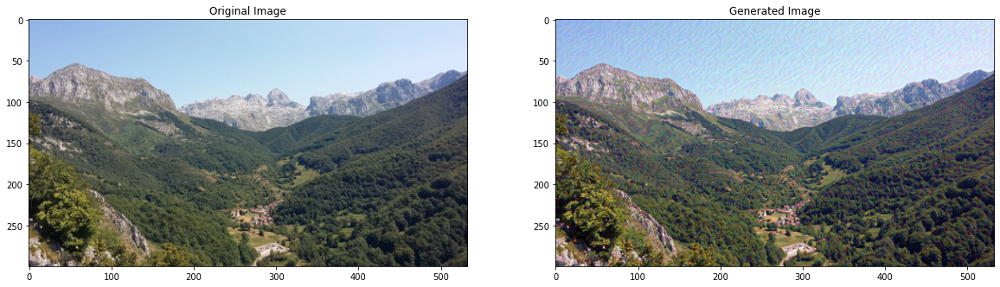

Iteracion 300 
Total Loss: 199123728.0 - Content Loss: 7.752184867858887 - Style Loss: 199.1237335205078


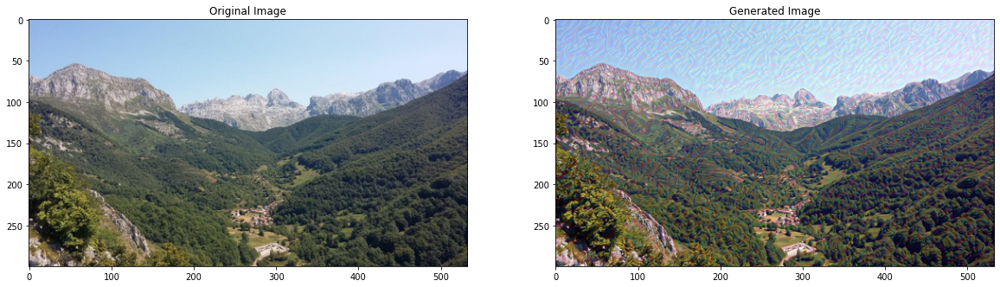

Iteracion 400 
Total Loss: 144393520.0 - Content Loss: 8.559531211853027 - Style Loss: 144.3935089111328


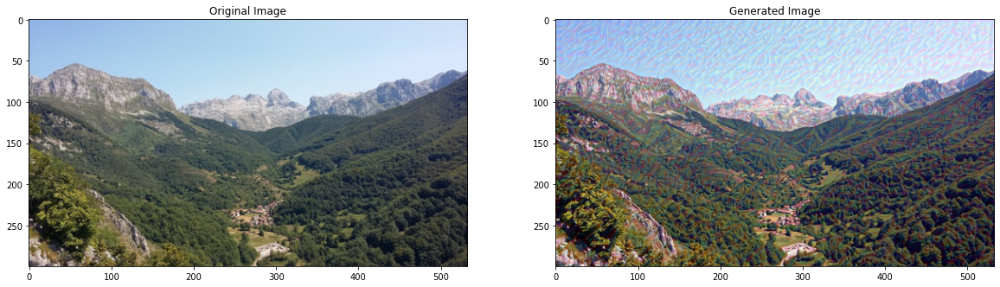

Iteracion 500 
Total Loss: 111644808.0 - Content Loss: 9.277073860168457 - Style Loss: 111.6447982788086


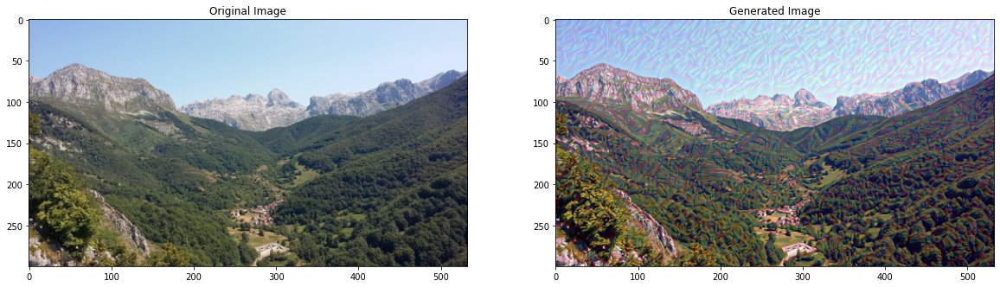

In [103]:
content_loss_array, style_loss_array, target6 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

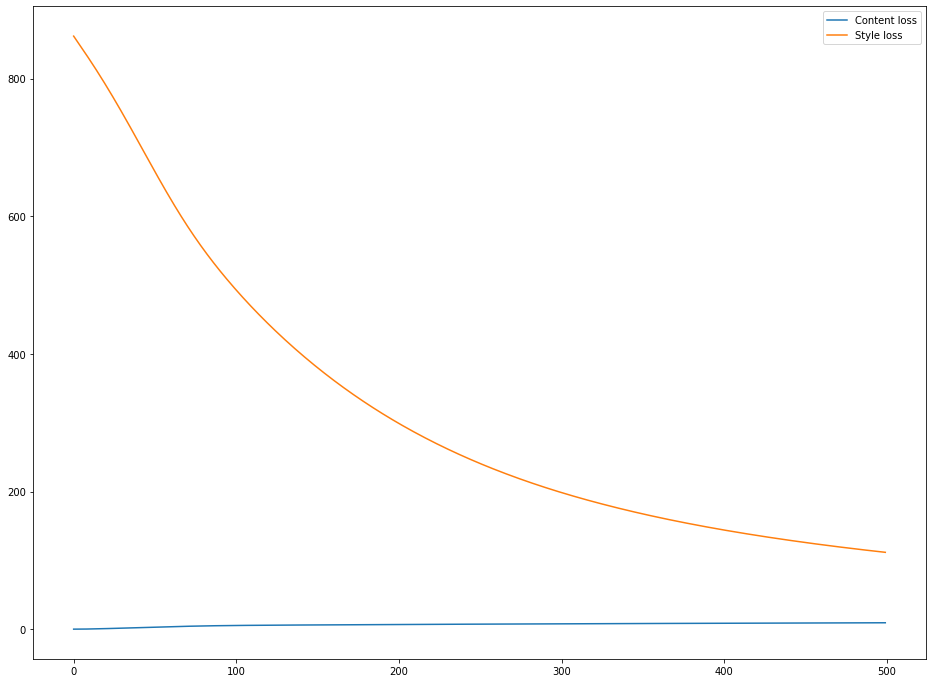

In [104]:
grafica_loss(content_loss_array, style_loss_array,"graf_6.png")

In [105]:
# Almacenamos imagen
save_target(target6, "06_learningrate_0.001.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Steps (etapas de entrenamiento): 1000**

In [106]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.1

steps = 1000 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 200

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.1 - Epoch: 1000
Iteracion 200 
Total Loss: 1508645.625 - Content Loss: 14.106484413146973 - Style Loss: 1.5086314678192139


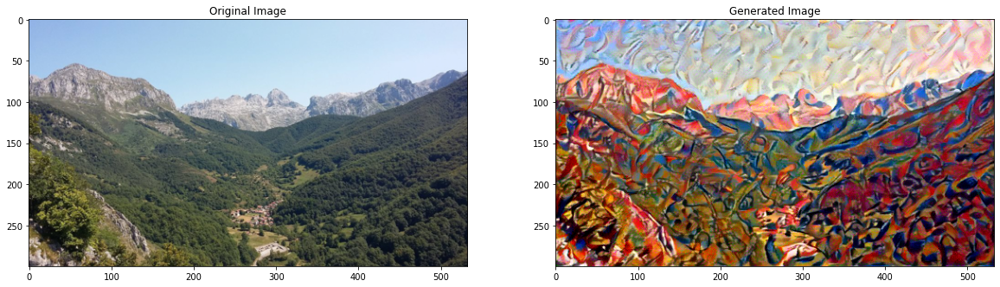

Iteracion 400 
Total Loss: 642988.875 - Content Loss: 14.504315376281738 - Style Loss: 0.6429743766784668


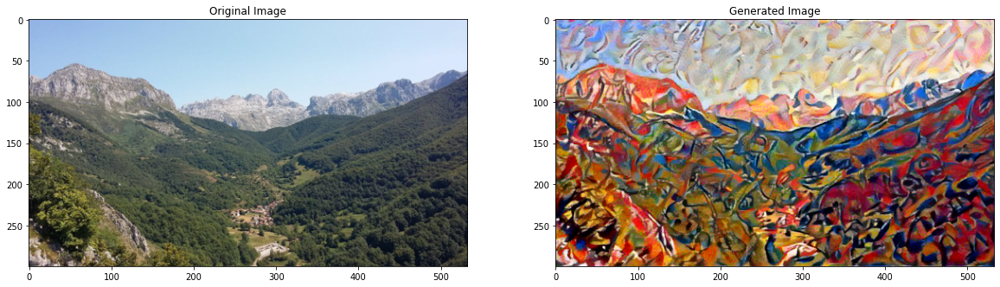

Iteracion 600 
Total Loss: 425274.1875 - Content Loss: 14.55599308013916 - Style Loss: 0.42525961995124817


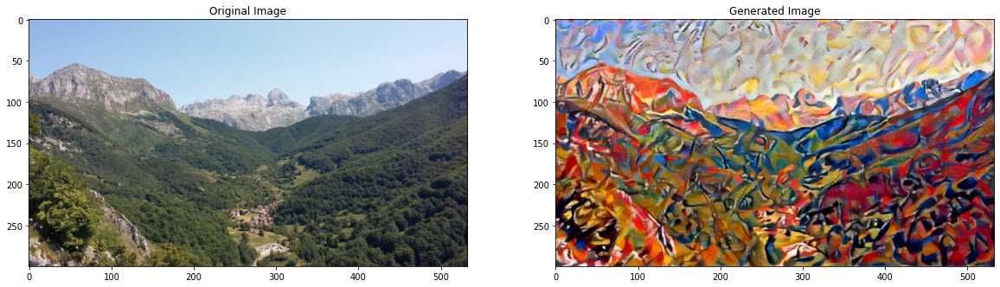

Iteracion 800 
Total Loss: 472829.4375 - Content Loss: 14.721400260925293 - Style Loss: 0.4728147089481354


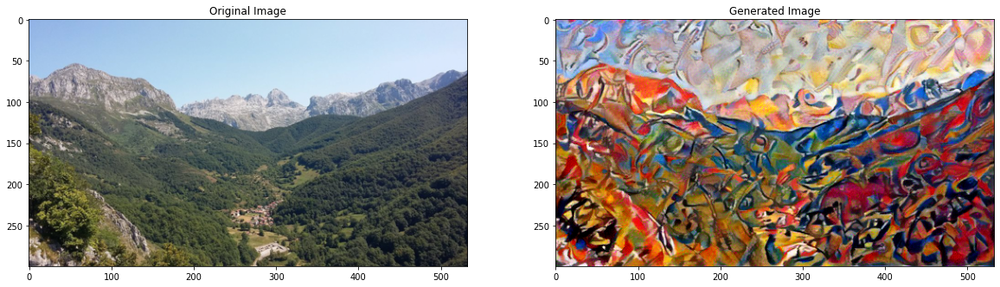

Iteracion 1000 
Total Loss: 484214.71875 - Content Loss: 14.69775676727295 - Style Loss: 0.48420003056526184


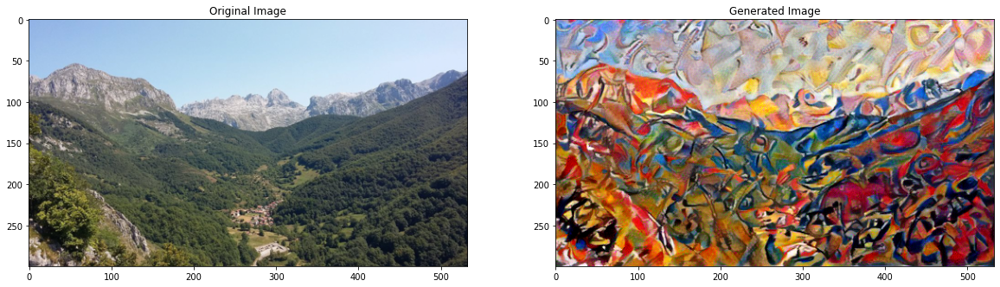

In [107]:
content_loss_array, style_loss_array, target7 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

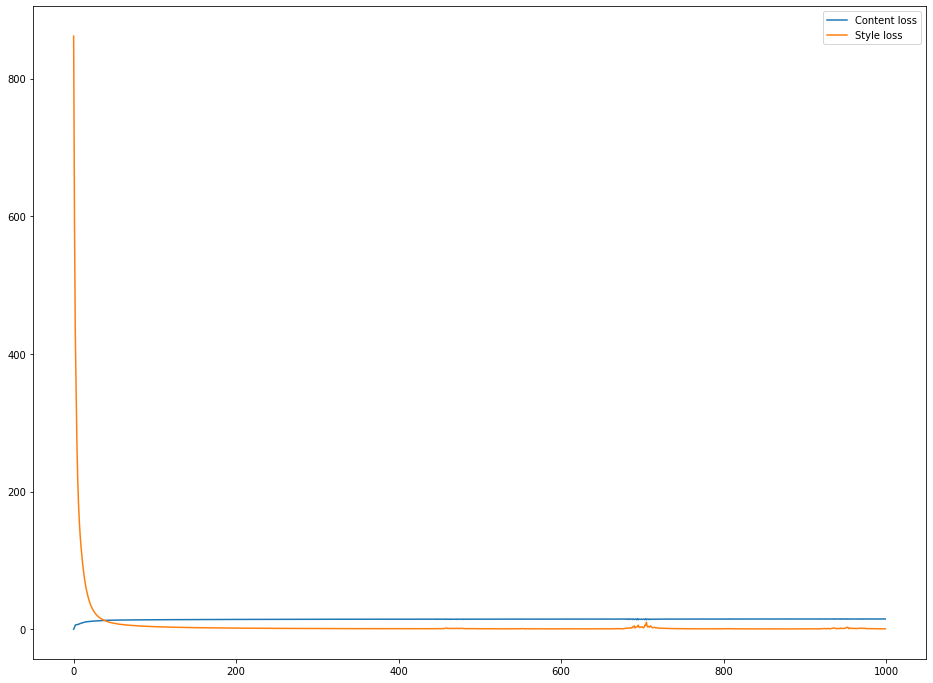

In [108]:
grafica_loss(content_loss_array, style_loss_array,"graf_7.png")

In [109]:
# Almacenamos imagen
save_target(target7, "07_steps_1000.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Steps (etapas de entrenamiento): 2000**

In [110]:
content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.1

steps = 2000 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 400

Optimizando con content_weight: 1 - style_weight: 1000000.0 - learning_rate: 0.1 - Epoch: 2000
Iteracion 400 
Total Loss: 644686.375 - Content Loss: 14.497133255004883 - Style Loss: 0.6446718573570251


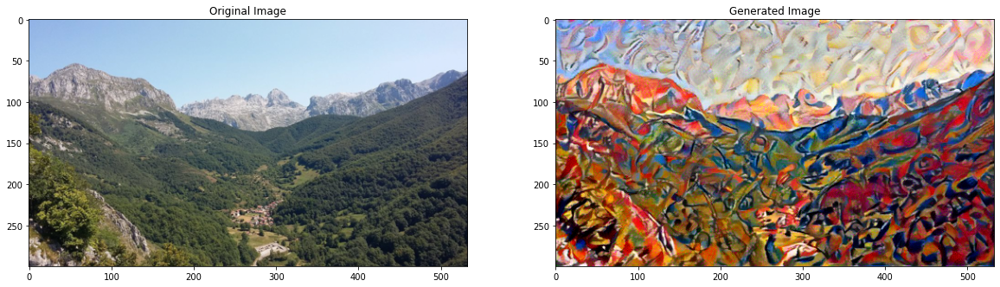

Iteracion 800 
Total Loss: 511030.0625 - Content Loss: 14.804963111877441 - Style Loss: 0.5110152363777161


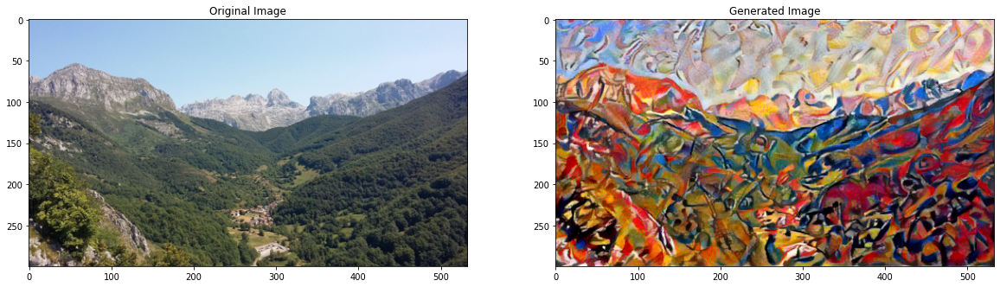

Iteracion 1200 
Total Loss: 356979.6875 - Content Loss: 14.751033782958984 - Style Loss: 0.35696494579315186


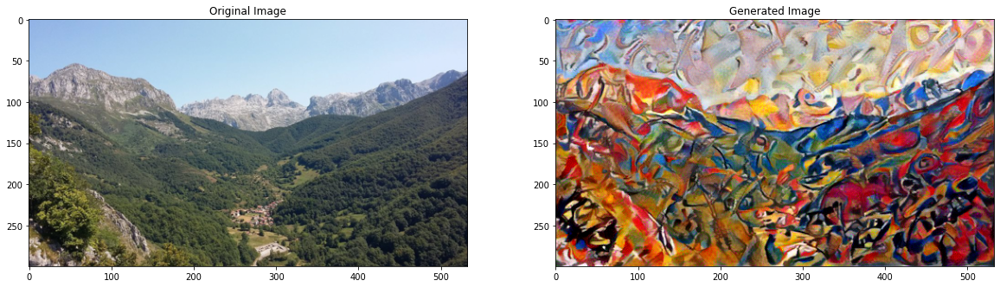

Iteracion 1600 
Total Loss: 405819.3125 - Content Loss: 14.831488609313965 - Style Loss: 0.40580445528030396


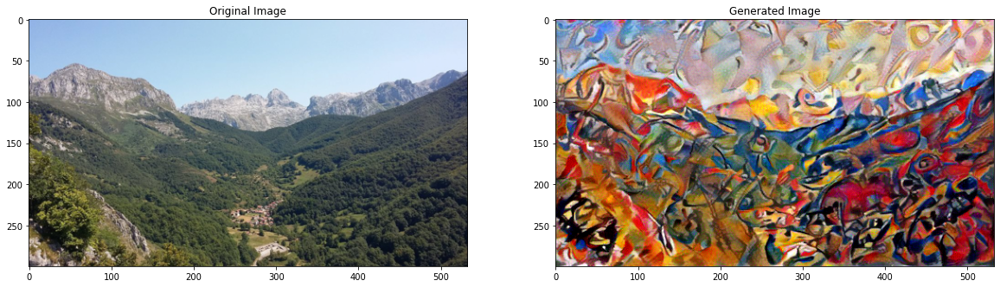

Iteracion 2000 
Total Loss: 320536.65625 - Content Loss: 14.936175346374512 - Style Loss: 0.3205217123031616


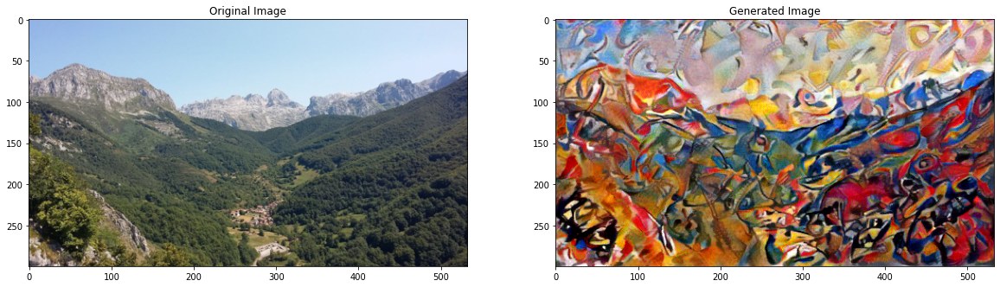

In [111]:
content_loss_array, style_loss_array, target8 = train_model(content,style, vgg_features, style_weights, content_weight, style_weight, learning_rate, steps, show_every)

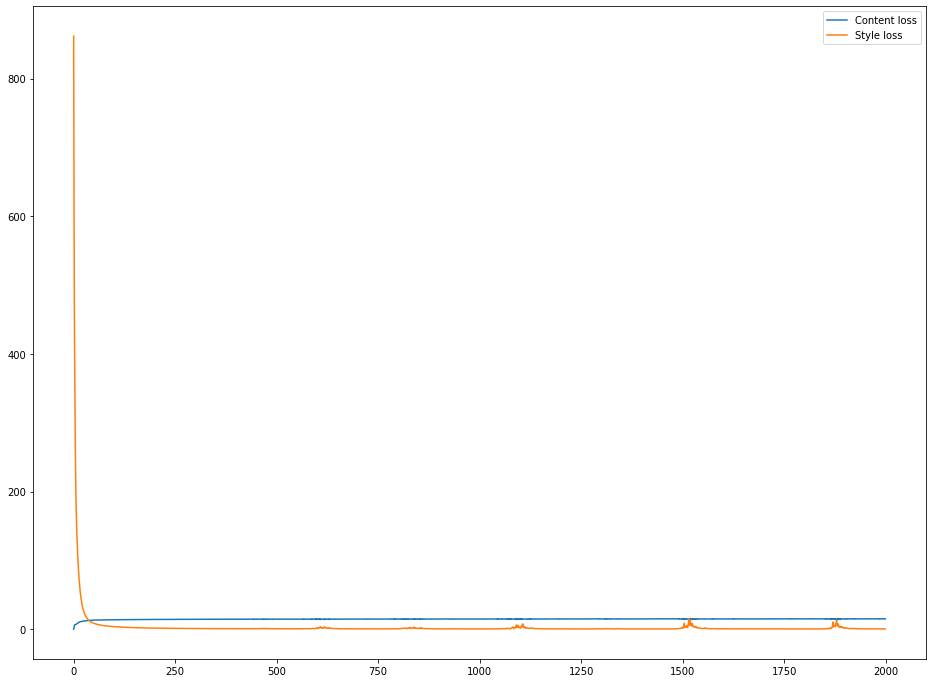

In [112]:
grafica_loss(content_loss_array, style_loss_array,"graf_8.png")

In [113]:
# Almacenamos imagen
save_target(target8, "08_steps_2000.jpg")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Graficamos Imagenes Generadas (target) y Plot:


**Originales**

Text(0.5, 1.0, 'Style Image')

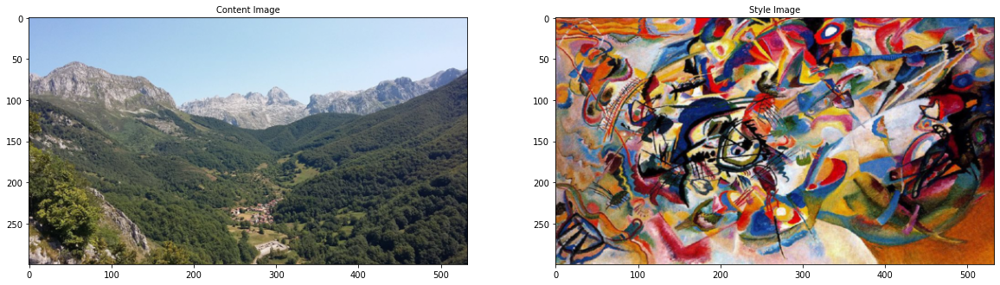

In [114]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax1.set_title("Content Image",fontsize = 10)
ax2.imshow(im_convert(style))
ax2.set_title("Style Image",fontsize = 10)

**Imagenes Generadas (Target) - Optimizando Content Weight y Style Weight**

Learning_rate:0.1

Epoch:500

Text(0.5, 1.0, 'Content Weight:1e2 - Style Weight:1e-2')

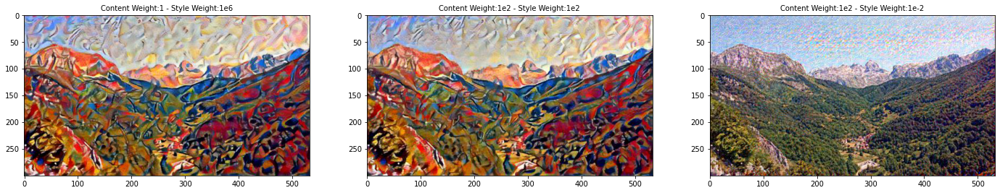

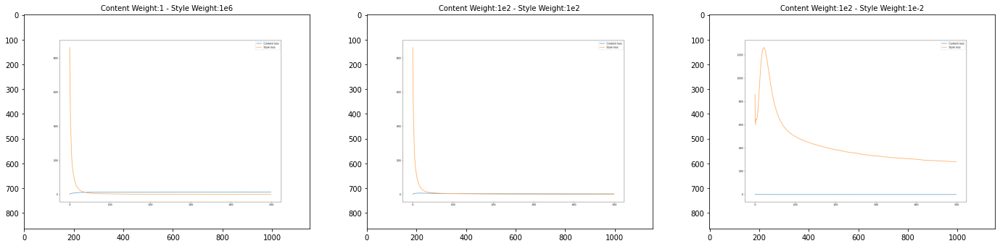

In [115]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
image1 = img.imread('/content/01_contenweight_1_styleweight_1e6.jpg')
ax1.imshow(image1)
ax1.set_title("Content Weight:1 - Style Weight:1e6",fontsize = 10)
image2 = img.imread('/content/02_contenweight_1e2_styleweight_1e2.jpg.jpg')
ax2.imshow(image2)
ax2.set_title("Content Weight:1e2 - Style Weight:1e2",fontsize = 10)
image3 = img.imread('/content/03_contenweight_1e2_styleweight_1e-2.jpg')
ax3.imshow(image3)
ax3.set_title("Content Weight:1e2 - Style Weight:1e-2",fontsize = 10)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
plt1 = img.imread('/content/graf_1.png')
ax1.imshow(plt1)
ax1.set_title("Content Weight:1 - Style Weight:1e6",fontsize = 10)
plt2 = img.imread('/content/graf_2.png')
ax2.imshow(plt2)
ax2.set_title("Content Weight:1e2 - Style Weight:1e2",fontsize = 10)
plt3 = img.imread('/content/graf_3.png')
ax3.imshow(plt3)
ax3.set_title("Content Weight:1e2 - Style Weight:1e-2",fontsize = 10)


**Imagenes Generadas (Target) - Optimizando Learning Rate**

Content Weight:1

Style Weight:1e6

Epoch:500

Text(0.5, 1.0, 'Learning Rate: 0.001')

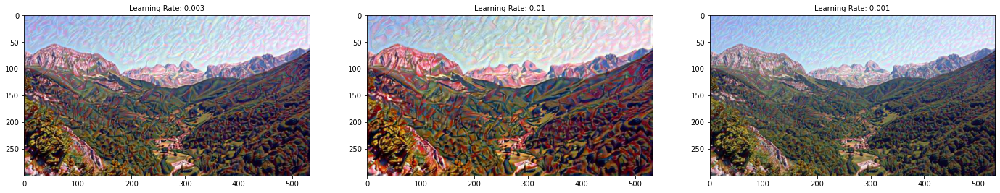

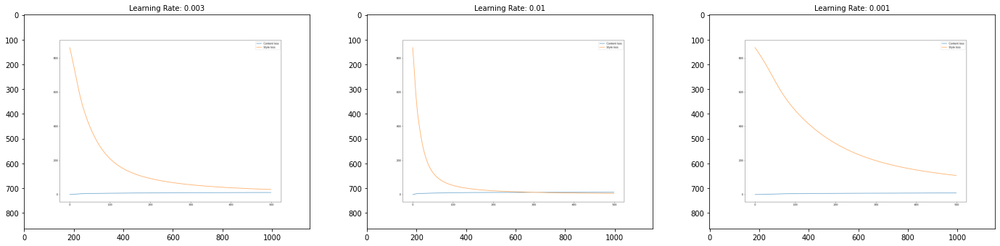

In [116]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
image1 = img.imread('/content/04_learningrate_0.003.jpg')
ax1.imshow(image1)
ax1.set_title("Learning Rate: 0.003",fontsize = 10)
image2 = img.imread('/content/05_learningrate_0.01.jpg')
ax2.imshow(image2)
ax2.set_title("Learning Rate: 0.01",fontsize = 10)
image3 = img.imread('/content/06_learningrate_0.001.jpg')
ax3.imshow(image3)
ax3.set_title("Learning Rate: 0.001",fontsize = 10)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
plt1 = img.imread('/content/graf_4.png')
ax1.imshow(plt1)
ax1.set_title("Learning Rate: 0.003",fontsize = 10)
plt2 = img.imread('/content/graf_5.png')
ax2.imshow(plt2)
ax2.set_title("Learning Rate: 0.01",fontsize = 10)
plt3 = img.imread('/content/graf_6.png')
ax3.imshow(plt3)
ax3.set_title("Learning Rate: 0.001",fontsize = 10)

**Imagenes Generadas (Target) - Optimizando Epoch**

Content Weight:1

Style Weight:1e6

Learning Rate: 0.1

Text(0.5, 1.0, 'Epoch : 2000')

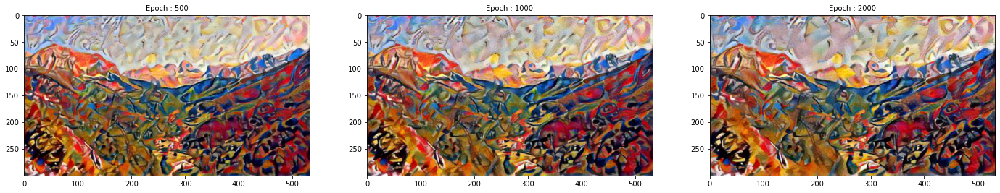

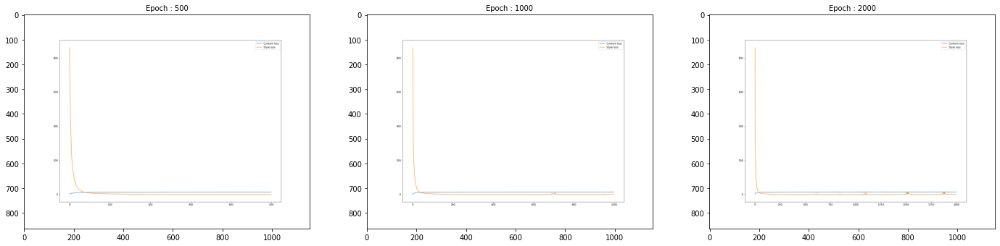

In [117]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
image1 = img.imread('/content/01_contenweight_1_styleweight_1e6.jpg')
ax1.imshow(image1)
ax1.set_title("Epoch : 500",fontsize = 10)
image2 = img.imread('/content/07_steps_1000.jpg')
ax2.imshow(image2)
ax2.set_title("Epoch : 1000",fontsize = 10)
image3 = img.imread('/content/08_steps_2000.jpg')
ax3.imshow(image3)
ax3.set_title("Epoch : 2000",fontsize = 10)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 18))
plt1 = img.imread('/content/graf_1.png')
ax1.imshow(plt1)
ax1.set_title("Epoch : 500",fontsize = 10)
plt2 = img.imread('/content/graf_7.png')
ax2.imshow(plt2)
ax2.set_title("Epoch : 1000",fontsize = 10)
plt3 = img.imread('/content/graf_8.png')
ax3.imshow(plt3)
ax3.set_title("Epoch : 2000",fontsize = 10)

# Preguntas
### 1 - ¿Cuántas capas lineales contiene el clasificador de VGG19?

Podemos ver que contiene 3 capas lineales:

- (0): Linear(in_features=25088, out_features=4096, bias=True)
- (3): Linear(in_features=4096, out_features=4096, bias=True)
- (6): Linear(in_features=4096, out_features=1000, bias=True)

### 2 - ¿Cuántas clases distintas puede reconocer VGG19 en su configuración original?

Por defecto contiene 1000 clases distintas, esto se puede obtener de la última capa lineal desde el parámetro out_features = 1000.

### 3 - Indica los identificadores de capas convolucionales a continuación de capas de max pooling

- (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
- (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
- (19): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
- (28): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

### 4 - ¿Qué influencia tienen los cambios solicitados (content_weight, style_weight, learning rate, steps) en las imágenes intermedias y en la imagen resultante?

Vamos a realizar el analisis desde los diferentes parámetros y viendo el resultado en la última sección:

- Pesos de Content y Style: La fusión de ambas imagenes se aprecia con mayor presencia cuando nuestro style weight es grande (1e6) y como se aprecia en el gráfico ya en las primeras iteraciones ya se genera la fusión de la imagen. Mientras que en valores más cercanos a 0 (1e2) la fusión es mucho menor y para llegar a resultados similares al primer experimento (1e6 de style weight) se debe seguir iterando por valores mucho mayores, lo que implica un mayor consumo computacional.

- Learning Rate: Mientras más cercano a 1 es el learning rate mayor será la fusión de las imagenes. En el gráfico tambien se aprecia que en la iteración 200 se produce la fusión con learning rate 0.01. Aunque en la primera parte del experimento con los valores por defecto con Learning rate de 0.1 la fusón fue mucho más rápida (en la iteración cercanas a 20).

- Steps: Tomando en cuenta los valores por defecto, y solo cambiando las iteraciones, podemos darnos cuenta que no causaba un mayor cambio, ya que el valor de Learning rate era de 0.1, siendo este valor junto a los pesos de style grandes hacen que la fusión sea rápida (cercana en la iteración 20).

Conclusión:

Podemos indicar que la fusíon de las imagenes se pueden asociar principalmente a valores altos de style weight (1e6) y learning ratios altos (valores más cercanos a 1), eligiendo valores adecuados permite llegar a una fusón mucho más rápida (menos steps).